# Feature map visualizations
This notebook is built specificaly for creating neat visualizations of the intermediate feature maps in a fully convolutional neural network.
The purpose is to help explain how neural networks process information and come up with solutions to the task they are presented to.

In [1]:
import platform
import sys
import os
import os.path as osp
import datetime
import logging
import numpy as np
import pickle
import matplotlib.pyplot as plt

# Magic used by the notebook to show figures inline

%matplotlib inline
# matplotlib default values
plt.rcParams["figure.figsize"] = (20.0, 16.0)
plt.rcParams["image.interpolation"] = "nearest"
plt.rcParams["image.cmap"] = "jet"

# auto-reloading packages
%load_ext autoreload
%autoreload 2

# local package
from mmciad.utils.io import create_samples, read_samples, load_slides, load_slides_as_dict
from mmciad.utils.generator import DataGenerator
from mmciad.utils.u_net import u_net
from mmciad.utils.u_resnet import u_resnet
from mmciad.utils.custom_loss import weighted_loss, jaccard2_loss, tversky_loss, categorical_focal_loss, get_weighted_categorical_crossentropy
from mmciad.utils.preprocessing import calculate_stats, augmentor, calculate_class_weights

from skimage.io import imread, imsave
from glob import glob

class_map = {
    "Background": 0,
    "Other": 1,
    "Epithelium": 2,
    "Glandular tissue": 3,
    "Necrosis": 4,
    "Stroma": 5,
    "Muscular": 6,
    "Inflamed": 7,
    "Ulcer": 8,
    "Dysplasia": 9,
    "Keratin pearl": 10,
    "Cancer": 11,
    "IGNORE": 12,
}

class_colors = {
    0: [0, 0, 0],
    1: [128, 128, 128],
    2: [75, 195, 0],
    3: [0, 26, 128],
    4: [94, 243, 255],
    5: [255, 179, 128],
    6: [217, 30, 242],
    7: [204, 102, 51],
    8: [153, 51, 0],
    9: [245, 223, 37],
    10: [179, 230, 179],
    11: [179, 26, 26],
    12: [255, 255, 255],
}
active_labels = [0, 1, 2, 3, 5, 6, 7, 9, 10, 11, 12]
active_classes = [sorted(class_map, key=class_map.get)[i] for i in active_labels]
print(active_classes)
colorvec = np.asarray([class_colors[i] for i in active_labels])
num_cls = len(active_labels)
print(colorvec.shape)
ignore_cls = 12

path = "./data/"
data_path = "./data/"
train_path = "train/"
val_path = "val/"
weight_path = "./weights/"
bg_class = class_map["Background"]
ignore_color = class_colors[12]
np.random.seed(1992)

Using TensorFlow backend.


['Background', 'Other', 'Epithelium', 'Glandular tissue', 'Stroma', 'Muscular', 'Inflamed', 'Dysplasia', 'Keratin pearl', 'Cancer', 'IGNORE']
(11, 3)


In [2]:
def sliding_window(image, stepSize, windowSize):
    # slide a window across the image
    for y in range(0, image.shape[1] - windowSize[0] + stepSize, stepSize):
        for x in range(0, image.shape[0] - windowSize[1] + stepSize, stepSize):
            # yield the current window
            res_img = image[x : x + windowSize[0], y : y + windowSize[1]]
            change = False
            if res_img.shape[1] != windowSize[1]:
                y = image.shape[1] - windowSize[1]
                change = True
            if res_img.shape[0] != windowSize[0]:
                x = image.shape[0] - windowSize[0]
                change = True
            if change:
                res_img = image[x : x + windowSize[0], y : y + windowSize[1]]
            yield (x, y, x + windowSize[0], y + windowSize[1], res_img)


def predict_window(slide, stepSize=1000, wsize=1024):
    X, Y, _ = slide.shape
    if (X > wsize) & (Y > wsize):
        output = np.ones(shape=(X, Y, num_cls))
        for (x, y, dx, dy, I) in sliding_window(slide, wsize, (wsize, wsize)):
            prediction = model.predict(np.expand_dims(I, axis=0))
            output[x:dx, y:dy, :] = prediction
        return output
    else:
        output = model.predict(slide)
        return output

def multi_output_predict_window(slide, outputs, nb_filters, sampling, stepSize=1000, wsize=1024):
    X, Y, _ = slide.shape
    num_outputs = len(outputs)
    s = sampling
    if (X > wsize) & (Y > wsize):
        output = [np.ones(shape=(int(X/2**s[i]), int(Y/2**s[i]), nb_filters[i])) for i in range(num_outputs)]
        for (x, y, dx, dy, I) in sliding_window(slide, wsize, (wsize, wsize)):
            prediction = model.predict(np.expand_dims(I, axis=0))
            for i in range(num_outputs):
                sx, sy, sdx, sdy = int(x/2**s[i]), int(y/2**s[i]), int(dx/2**s[i]), int(dy/2**s[i])
                output[i][sx:sdx, sy:sdy, :] = prediction[i]
        return output
    else:
        output = model.predict(slide)
        return output

In [3]:
train_m, train_s, x_min, x_max = calculate_stats(path=data_path, local=False)

In [4]:
train_slides = load_slides_as_dict(path, "train", train_m, train_s, (x_min, x_max), False)
results_path = "./results/"

In [6]:
from keras.models import Model, load_model
resnet_output_layers = [7, 18, 29, 66, 79]
resnet_sampling = [1, 2, 3, 2, 1]
resnet_filters = [32, 64, 128, 64, 32]
unet_output_layers = [3, 6, 11, 16, 22, 28, 34, 40, 46]
unet_sampling = [0, 1, 2, 3, 4, 3, 2, 1, 0]
unet_filters = [64, 128, 256, 512, 1024, 512, 256, 128, 64]
output_layers = unet_output_layers
output_filters = unet_filters
output_sampling = unet_sampling
train_date = "2019-08-09"
#model = load_model(weight_path + train_date + "/cat_CE Adam/talos_U-net_model-init_he_normal-act_relu-decay_0.0-drop_0-weights_False-pretrain_0-sigma_0.h5")
model = load_model(weight_path + train_date + "/cat_CE Adam/talos_U-net_model-init_he_normal-act_relu-decay_0.0-drop_0-weights_False-pretrain_0-sigma_0.h5")
outputs = [model.layers[i].output for i in output_layers]
model = Model(inputs=model.inputs, outputs=outputs)

# load the image with the required shape
img = train_slides["N8b"]

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.
Instructions for updating:
Deprecated in favor of operator or tf.math.divide.


In [7]:
# get feature map for first hidden layer

feature_maps = multi_output_predict_window(np.squeeze(img), output_layers, output_filters, output_sampling)

In [8]:
feature_maps[0].shape

(4620, 3761, 64)

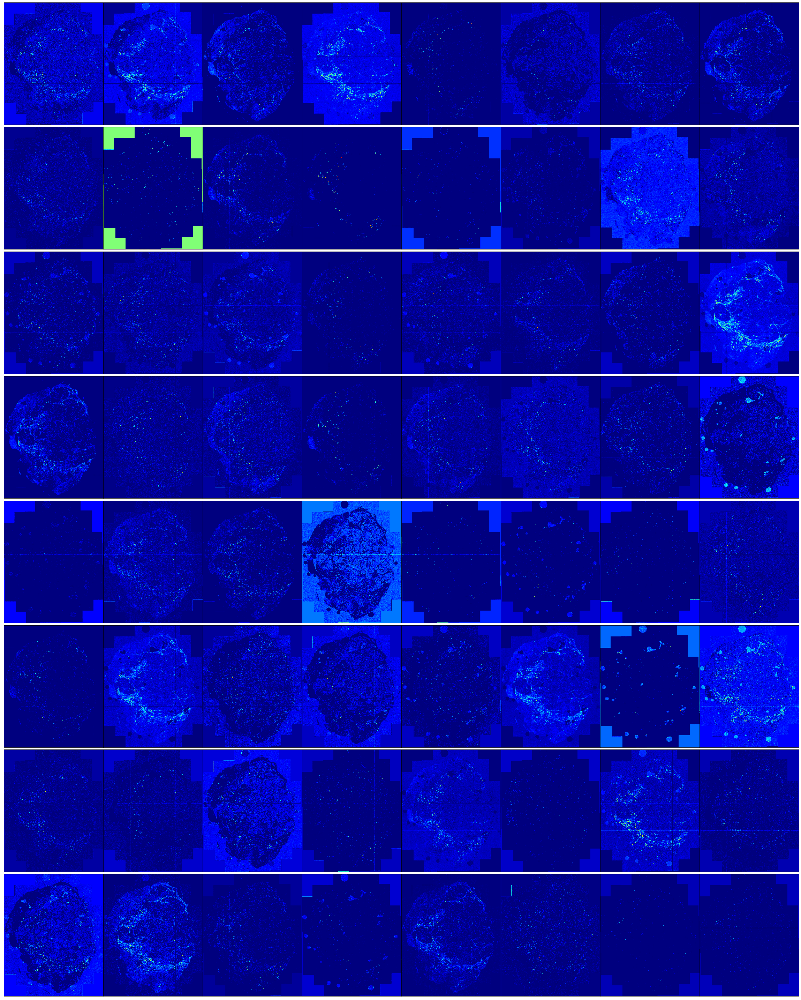

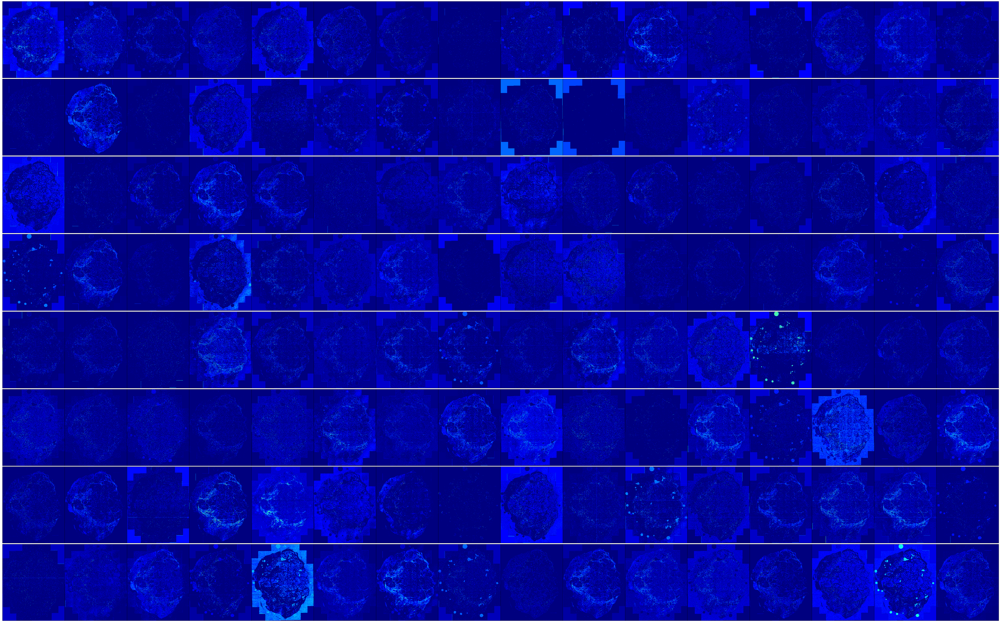

In [ ]:
# plot the output from each block
plt.rcParams['figure.figsize'] = (24.6, 20.0)
square = [8, 16, 16, 16, 32, 16, 16, 16, 8]
for level, fmap in enumerate(feature_maps, 1):
    # plot all 64 maps in an 8x8 squares
    ix = 0
    cols = square[level-1]
    rows = fmap.shape[-1]//cols
    fig,ax = plt.subplots(
        nrows=rows,
        ncols=cols,
        sharex=True,
        sharey=True,
        figsize=(4.0*cols, 5.0*rows),
        gridspec_kw={'hspace': 0, 'wspace': 0}
    )
    for i in range(rows):
        for j in range(cols):
            if ix < fmap.shape[-1]:
                # specify subplot and turn of axis
                ax[i, j].set_xticks([])
                ax[i, j].set_yticks([])
                # plot filter channel in grayscale
                ax[i, j].imshow(fmap[:, :, ix])
                ix += 1
    # show the figure
    fig.tight_layout()
    #fig.suptitle('Feature maps from block {}'.format(level))
    plt.show()
    fig.savefig(osp.join(results_path, train_date, "U-net", "N8b-block" + str(level) + "-featuremap.png"))

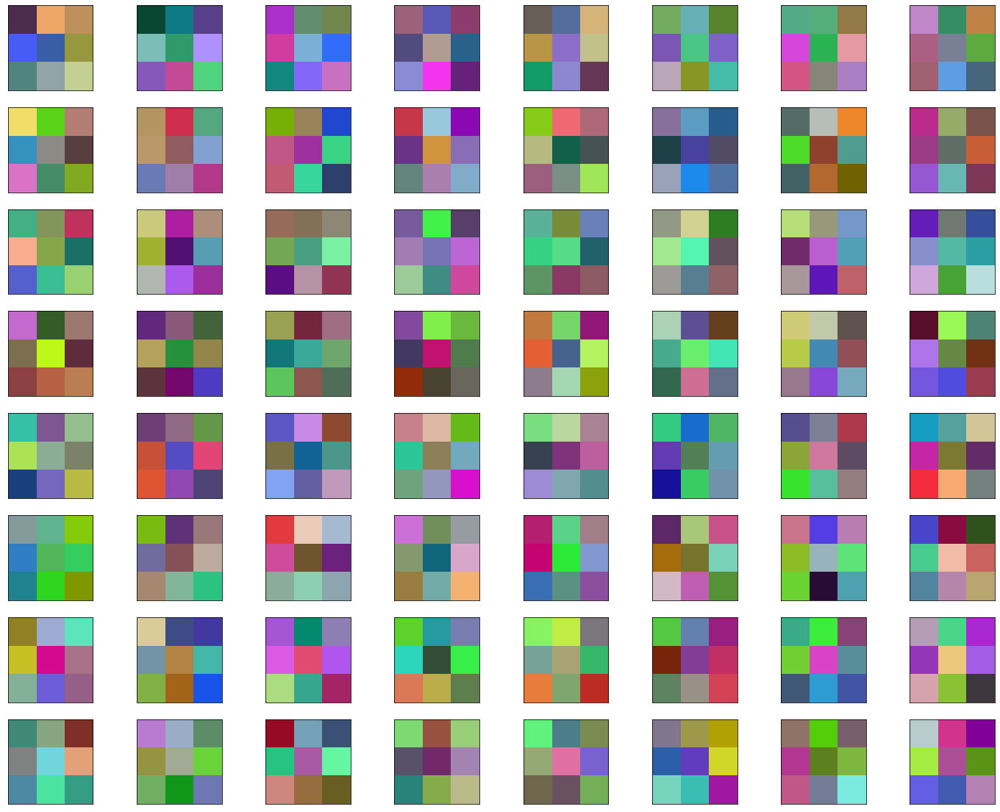

In [15]:
# retrieve weights from the second hidden layer
filters, biases = model.layers[1].get_weights()
# normalize filter values to 0-1 so we can visualize them
f_min, f_max = filters.min(), filters.max()
filters = (filters - f_min) / (f_max - f_min)
# plot first few filters
n_filters, ix = 64, 1
for i in range(n_filters):
    # get the filter
    f = filters[:, :, :, i]
    # plot each channel separately
    # specify subplot and turn of axis
    ax = plt.subplot(8, 8, ix)
    ax.set_xticks([])
    ax.set_yticks([])
    # plot filter channel in grayscale
    plt.imshow(f[:, :])
    ix += 1
# show the figure
plt.show()